In [1]:
import os
import pandas as pd
from pycaret import *

In [2]:
data_loc='./data'

In [3]:
data=pd.DataFrame(pd.read_csv(os.path.join(data_loc,'train.csv')))
data.head()

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,...,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,class
0,0,tcp,ftp_data,SF,491,0,0,0,0,0,...,25,0.17,0.03,0.17,0.00,0.00,0.00,0.05,0.00,normal
1,0,udp,other,SF,146,0,0,0,0,0,...,1,0.00,0.60,0.88,0.00,0.00,0.00,0.00,0.00,normal
2,0,tcp,private,S0,0,0,0,0,0,0,...,26,0.10,0.05,0.00,0.00,1.00,1.00,0.00,0.00,anomaly
3,0,tcp,http,SF,232,8153,0,0,0,0,...,255,1.00,0.00,0.03,0.04,0.03,0.01,0.00,0.01,normal
4,0,tcp,http,SF,199,420,0,0,0,0,...,255,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,normal


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25192 entries, 0 to 25191
Data columns (total 42 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   duration                     25192 non-null  int64  
 1   protocol_type                25192 non-null  object 
 2   service                      25192 non-null  object 
 3   flag                         25192 non-null  object 
 4   src_bytes                    25192 non-null  int64  
 5   dst_bytes                    25192 non-null  int64  
 6   land                         25192 non-null  int64  
 7   wrong_fragment               25192 non-null  int64  
 8   urgent                       25192 non-null  int64  
 9   hot                          25192 non-null  int64  
 10  num_failed_logins            25192 non-null  int64  
 11  logged_in                    25192 non-null  int64  
 12  num_compromised              25192 non-null  int64  
 13  root_shell      

In [9]:
temp_data=data.drop(columns=['protocol_type','service','flag','class'])
num_features=temp_data.columns.tolist()
print(num_features)

['duration', 'src_bytes', 'dst_bytes', 'land', 'wrong_fragment', 'urgent', 'hot', 'num_failed_logins', 'logged_in', 'num_compromised', 'root_shell', 'su_attempted', 'num_root', 'num_file_creations', 'num_shells', 'num_access_files', 'num_outbound_cmds', 'is_host_login', 'is_guest_login', 'count', 'srv_count', 'serror_rate', 'srv_serror_rate', 'rerror_rate', 'srv_rerror_rate', 'same_srv_rate', 'diff_srv_rate', 'srv_diff_host_rate', 'dst_host_count', 'dst_host_srv_count', 'dst_host_same_srv_rate', 'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate', 'dst_host_srv_diff_host_rate', 'dst_host_serror_rate', 'dst_host_srv_serror_rate', 'dst_host_rerror_rate', 'dst_host_srv_rerror_rate']


In [10]:
updated_data=data.copy()
for i in updated_data:
    if i in num_features:
        updated_data[i]=updated_data[i].astype(float)
    else:
        updated_data[i]=updated_data[i].astype('category')

updated_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25192 entries, 0 to 25191
Data columns (total 42 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   duration                     25192 non-null  float64 
 1   protocol_type                25192 non-null  category
 2   service                      25192 non-null  category
 3   flag                         25192 non-null  category
 4   src_bytes                    25192 non-null  float64 
 5   dst_bytes                    25192 non-null  float64 
 6   land                         25192 non-null  float64 
 7   wrong_fragment               25192 non-null  float64 
 8   urgent                       25192 non-null  float64 
 9   hot                          25192 non-null  float64 
 10  num_failed_logins            25192 non-null  float64 
 11  logged_in                    25192 non-null  float64 
 12  num_compromised              25192 non-null  float64 
 13  r

K Means Clustering Technique

In [11]:
from pycaret.clustering import *

In [25]:
kmeans=setup(data=updated_data,preprocess=True,categorical_features=['protocol_type','service','flag','class'],numeric_features=num_features,n_jobs=-1,use_gpu=True)

,Description,Value
0,session_id,1703
1,Original Data,"(25192, 43)"
2,Missing Values,False
3,Numeric Features,38
4,Categorical Features,5
5,Ordinal Features,False
6,High Cardinality Features,False
7,High Cardinality Method,None
8,Transformed Data,"(25192, 125)"
9,CPU Jobs,-1


In [26]:
kmeans=create_model(model='kmeans',num_clusters=35,round=4)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.7162,1.281572e+09,0.2534,0,0,0


In [27]:
plot_model(kmeans,plot='cluster')

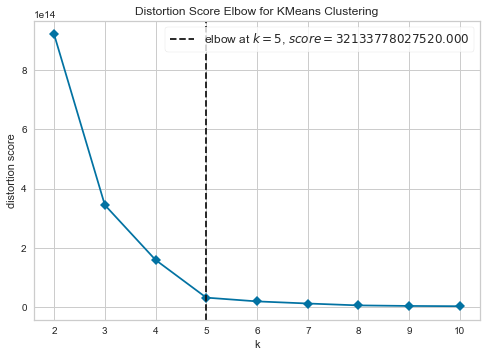

In [28]:
plot_model(kmeans,plot='elbow')

In [29]:
kmeans=create_model(model='kmeans',num_clusters=5,round=4)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.9967,2.872228e+07,0.1195,0,0,0


In [30]:
kmeans_df=assign_model(kmeans)

In [31]:
plot_model(model=kmeans,plot='cluster')

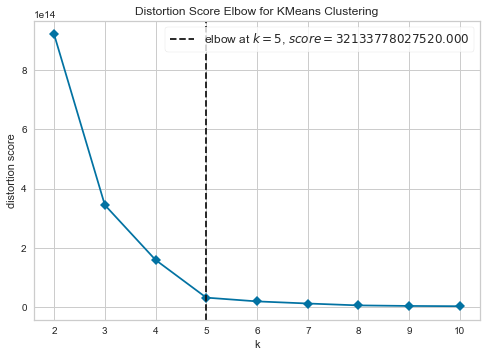

In [32]:
plot_model(model=kmeans,plot='elbow')

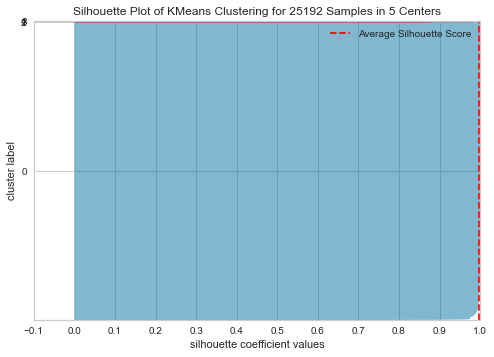

In [33]:
plot_model(model=kmeans,plot='silhouette')

In [34]:
plot_model(model=kmeans,plot='distribution')

In [35]:
updated_data['Cluster']=kmeans_df['Cluster']
updated_data['Cluster'].value_counts()
cluster_info = pd.DataFrame(updated_data['Cluster'].value_counts().reset_index().values, columns=["Cluster", "No. of Data"])
cluster_info.head()

,Cluster,No. of Data
0,Cluster 0,25118
1,Cluster 3,50
2,Cluster 2,16
3,Cluster 4,7
4,Cluster 1,1


In [36]:
updated_data['Cluster']=kmeans_df['Cluster']
cluster_info=[]
for i in range(0,len(updated_data['Cluster'].unique())):
    with open ('cluster_info.txt',mode='a',encoding='utf-8') as fp:
        cluster_details='Cluster {0} \n\n {1} \n\n'.format(i,updated_data[updated_data['Cluster']=='Cluster '+str(i)].mean())
        fp.write(cluster_details)

In [38]:
updated_data.to_csv(os.path.join(data_loc,'updated_data.csv'),index=False)

Using Decision Tree Classifer

In [ ]:
tuned_dt_kmeans=tune_model(model='kmeans',supervised_target='label',supervised_estimator='dt',optimize='Accuracy',fold=20)

In [ ]:
plot_model(tuned_dt_kmeans,plot='silhouette')

In [ ]:
plot_model(tuned_dt_kmeans,plot='cluster')

In [ ]:
plot_model(tuned_dt_kmeans,plot='distribution')

In [ ]:
plot_model(tuned_dt_kmeans,plot='elbow')

In [ ]:
cluster_info=[]
for i in range(0,len(updated_data['Cluster'].unique())):
    with open ('cluster_.txt',mode='a',encoding='utf-8') as fp:
        cluster_details='Cluster {0} \n\n {1} \n\n'.format(i,updated_data[updated_data['Cluster']=='Cluster '+str(i)].mean())
        fp.write(cluster_details)